<a href="https://colab.research.google.com/github/mellamonaranja/read_and_write_image_data_using_TFRecords/blob/main/read_and_write_image_data_using_TFRecords.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import tensorflow as tf

import numpy as np
import IPython.display as display

In [2]:
# The following functions can be used to convert a value to a type compatible
# with tf.train.Example.

def _bytes_feature(value):
  """Returns a bytes_list from a string / byte."""
  if isinstance(value, type(tf.constant(0))):
    value = value.numpy() # BytesList won't unpack a string from an EagerTensor.
  return tf.train.Feature(bytes_list=tf.train.BytesList(value=[value]))

def _float_feature(value):
  """Returns a float_list from a float / double."""
  return tf.train.Feature(float_list=tf.train.FloatList(value=[value]))

def _int64_feature(value):
  """Returns an int64_list from a bool / enum / int / uint."""
  return tf.train.Feature(int64_list=tf.train.Int64List(value=[value]))

In [3]:
# The number of observations in the dataset.
n_observations = int(1e4)

# Boolean feature, encoded as False or True.
feature0 = np.random.choice([False, True], n_observations)

# Integer feature, random from 0 to 4.
feature1 = np.random.randint(0, 5, n_observations)

# String feature.
strings = np.array([b'cat', b'dog', b'chicken', b'horse', b'goat'])
feature2 = strings[feature1]

# Float feature, from a standard normal distribution.
feature3 = np.random.randn(n_observations)

In [62]:
@tf.py_function(Tout=tf.string)
def serialize_example(feature0, feature1, feature2, feature3):
  """
  Creates a tf.train.Example message ready to be written to a file.
  """
  # Create a dictionary mapping the feature name to the tf.train.Example-compatible
  # data type.
  feature = {
      'feature0': _int64_feature(feature0),
      'feature1': _int64_feature(feature1),
      'feature2': _bytes_feature(feature2),
      'feature3': _float_feature(feature3),
  }

  # Create a Features message using tf.train.Example.

  example_proto = tf.train.Example(features=tf.train.Features(feature=feature))
  return example_proto.SerializeToString()

In [49]:
filename = 'test.tfrecord'

In [50]:
# Write the `tf.train.Example` observations to the file.
with tf.io.TFRecordWriter(filename) as writer:
  for i in range(n_observations):
    example = serialize_example(feature0[i], feature1[i], feature2[i], feature3[i])
    writer.write(example.numpy())

In [51]:
filenames=[filename]
raw_dataset=tf.data.TFRecordDataset(filenames)

In [53]:
for raw_record in raw_dataset.take(5):
  example=tf.train.Example()
  example.ParseFromString(raw_record.numpy())
  print(example)

features {
  feature {
    key: "feature0"
    value {
      int64_list {
        value: 1
      }
    }
  }
  feature {
    key: "feature1"
    value {
      int64_list {
        value: 3
      }
    }
  }
  feature {
    key: "feature2"
    value {
      bytes_list {
        value: "horse"
      }
    }
  }
  feature {
    key: "feature3"
    value {
      float_list {
        value: -1.8753794431686401
      }
    }
  }
}

features {
  feature {
    key: "feature0"
    value {
      int64_list {
        value: 0
      }
    }
  }
  feature {
    key: "feature1"
    value {
      int64_list {
        value: 2
      }
    }
  }
  feature {
    key: "feature2"
    value {
      bytes_list {
        value: "chicken"
      }
    }
  }
  feature {
    key: "feature3"
    value {
      float_list {
        value: -1.2236825227737427
      }
    }
  }
}

features {
  feature {
    key: "feature0"
    value {
      int64_list {
        value: 1
      }
    }
  }
  feature {
    key: "feature

In [10]:
type(raw_dataset)

tensorflow.python.data.ops.readers.TFRecordDatasetV2

In [11]:
array = [[5, 6, 2, 7, 1],
         [4, 9, 2, 9, 3]]



Taking Indices
 [5 1]


In [27]:
print(np.take(array, [0,4],axis=1))

[[5 1]
 [4 3]]


In [9]:
result={}
for key,feature in example.features.feature.items():
  kind=feature.WhichOneof('kind') #int64_list,bytes_list,int64_list,float_list
  result[key]=np.array(getattr(feature, kind).value)
result

{'feature0': array([1]),
 'feature3': array([-1.87537944]),
 'feature1': array([3]),
 'feature2': array([b'horse'], dtype='|S5')}

In [30]:
class Person:
    age = 23
    name = "Adam"

person = Person()

In [35]:
getattr(person, 'age')

23

In [34]:
print('the gender is:',getattr(person, 'gender','unknown'))

the gender is: unknown


In [39]:
getattr(person, 'gender','unknown')

'unknown'

In [45]:
filenames

['test.tfrecord']

In [47]:
raw_dataset=tf.data.TFRecordDataset(filenames)

In [52]:
for raw_record in raw_dataset.take(1):
  string=str(raw_record)
  raw=raw_record
  print(string==raw)

tf.Tensor(False, shape=(), dtype=bool)


In [50]:
for raw_record in raw_dataset.take(5):
  print(repr(raw_record))

<tf.Tensor: shape=(), dtype=string, numpy=b'\nR\n\x11\n\x08feature0\x12\x05\x1a\x03\n\x01\x00\n\x11\n\x08feature1\x12\x05\x1a\x03\n\x01\x04\n\x14\n\x08feature2\x12\x08\n\x06\n\x04goat\n\x14\n\x08feature3\x12\x08\x12\x06\n\x04\x975\x81\xbf'>
<tf.Tensor: shape=(), dtype=string, numpy=b'\nQ\n\x11\n\x08feature1\x12\x05\x1a\x03\n\x01\x01\n\x11\n\x08feature0\x12\x05\x1a\x03\n\x01\x01\n\x13\n\x08feature2\x12\x07\n\x05\n\x03dog\n\x14\n\x08feature3\x12\x08\x12\x06\n\x04\x12\xb3D\xbe'>
<tf.Tensor: shape=(), dtype=string, numpy=b'\nU\n\x11\n\x08feature1\x12\x05\x1a\x03\n\x01\x02\n\x11\n\x08feature0\x12\x05\x1a\x03\n\x01\x00\n\x17\n\x08feature2\x12\x0b\n\t\n\x07chicken\n\x14\n\x08feature3\x12\x08\x12\x06\n\x04\xf8\xdd{?'>
<tf.Tensor: shape=(), dtype=string, numpy=b'\nU\n\x17\n\x08feature2\x12\x0b\n\t\n\x07chicken\n\x11\n\x08feature0\x12\x05\x1a\x03\n\x01\x01\n\x14\n\x08feature3\x12\x08\x12\x06\n\x04|\xf0\x9c\xbf\n\x11\n\x08feature1\x12\x05\x1a\x03\n\x01\x02'>
<tf.Tensor: shape=(), dtype=string, nu

In [51]:
for raw_record in raw_dataset.take(5):
  print(raw_record)

tf.Tensor(b'\nR\n\x11\n\x08feature0\x12\x05\x1a\x03\n\x01\x00\n\x11\n\x08feature1\x12\x05\x1a\x03\n\x01\x04\n\x14\n\x08feature2\x12\x08\n\x06\n\x04goat\n\x14\n\x08feature3\x12\x08\x12\x06\n\x04\x975\x81\xbf', shape=(), dtype=string)
tf.Tensor(b'\nQ\n\x11\n\x08feature1\x12\x05\x1a\x03\n\x01\x01\n\x11\n\x08feature0\x12\x05\x1a\x03\n\x01\x01\n\x13\n\x08feature2\x12\x07\n\x05\n\x03dog\n\x14\n\x08feature3\x12\x08\x12\x06\n\x04\x12\xb3D\xbe', shape=(), dtype=string)
tf.Tensor(b'\nU\n\x11\n\x08feature1\x12\x05\x1a\x03\n\x01\x02\n\x11\n\x08feature0\x12\x05\x1a\x03\n\x01\x00\n\x17\n\x08feature2\x12\x0b\n\t\n\x07chicken\n\x14\n\x08feature3\x12\x08\x12\x06\n\x04\xf8\xdd{?', shape=(), dtype=string)
tf.Tensor(b'\nU\n\x17\n\x08feature2\x12\x0b\n\t\n\x07chicken\n\x11\n\x08feature0\x12\x05\x1a\x03\n\x01\x01\n\x14\n\x08feature3\x12\x08\x12\x06\n\x04|\xf0\x9c\xbf\n\x11\n\x08feature1\x12\x05\x1a\x03\n\x01\x02', shape=(), dtype=string)
tf.Tensor(b'\nS\n\x14\n\x08feature3\x12\x08\x12\x06\n\x04\xdd\xc1\xb3\

In [10]:
feature_description={
    'feature0':tf.io.FixedLenFeature([], tf.int64, default_value=0),
    'feature1':tf.io.FixedLenFeature([], tf.int64, default_value=0),
    'feature2':tf.io.FixedLenFeature([], tf.string, default_value=''),
    'feature3':tf.io.FixedLenFeature([], tf.float32, default_value=0.0)
}

def _parse_function(example_proto):
  return tf.io.parse_single_example(example_proto, feature_description)

In [13]:
parsed_dataset=raw_dataset.map(_parse_function)
for parsed_record in parsed_dataset.take(5):
  print(repr(parsed_record))

{'feature0': <tf.Tensor: shape=(), dtype=int64, numpy=1>, 'feature1': <tf.Tensor: shape=(), dtype=int64, numpy=3>, 'feature2': <tf.Tensor: shape=(), dtype=string, numpy=b'horse'>, 'feature3': <tf.Tensor: shape=(), dtype=float32, numpy=-1.8753794>}
{'feature0': <tf.Tensor: shape=(), dtype=int64, numpy=0>, 'feature1': <tf.Tensor: shape=(), dtype=int64, numpy=2>, 'feature2': <tf.Tensor: shape=(), dtype=string, numpy=b'chicken'>, 'feature3': <tf.Tensor: shape=(), dtype=float32, numpy=-1.2236825>}
{'feature0': <tf.Tensor: shape=(), dtype=int64, numpy=1>, 'feature1': <tf.Tensor: shape=(), dtype=int64, numpy=3>, 'feature2': <tf.Tensor: shape=(), dtype=string, numpy=b'horse'>, 'feature3': <tf.Tensor: shape=(), dtype=float32, numpy=-0.44908616>}
{'feature0': <tf.Tensor: shape=(), dtype=int64, numpy=1>, 'feature1': <tf.Tensor: shape=(), dtype=int64, numpy=0>, 'feature2': <tf.Tensor: shape=(), dtype=string, numpy=b'cat'>, 'feature3': <tf.Tensor: shape=(), dtype=float32, numpy=0.2243437>}
{'featur

In [35]:
kiki  = tf.keras.utils.get_file(
    'Mural_Studio_Ghibli_en_Aguascalientes_con_grafiti_encima_02.jpg',
    'https://upload.wikimedia.org/wikipedia/commons/f/f2/Mural_Studio_Ghibli_en_Aguascalientes_con_grafiti_encima_02.jpg')

5768541/5768541 [==============================] - 0s 0us/step


In [39]:
hyundai=tf.keras.utils.get_file('800px-2018_Hyundai_i30_(PD_MY18)_Active_5-door_hatchback_(2018-08-06)_01.jpg',
                                'https://upload.wikimedia.org/wikipedia/commons/e/ea/2018_Hyundai_i30_%28PD_MY18%29_Active_5-door_hatchback_%282018-08-06%29_01.jpg')

5768541/5768541 [==============================] - 0s 0us/step


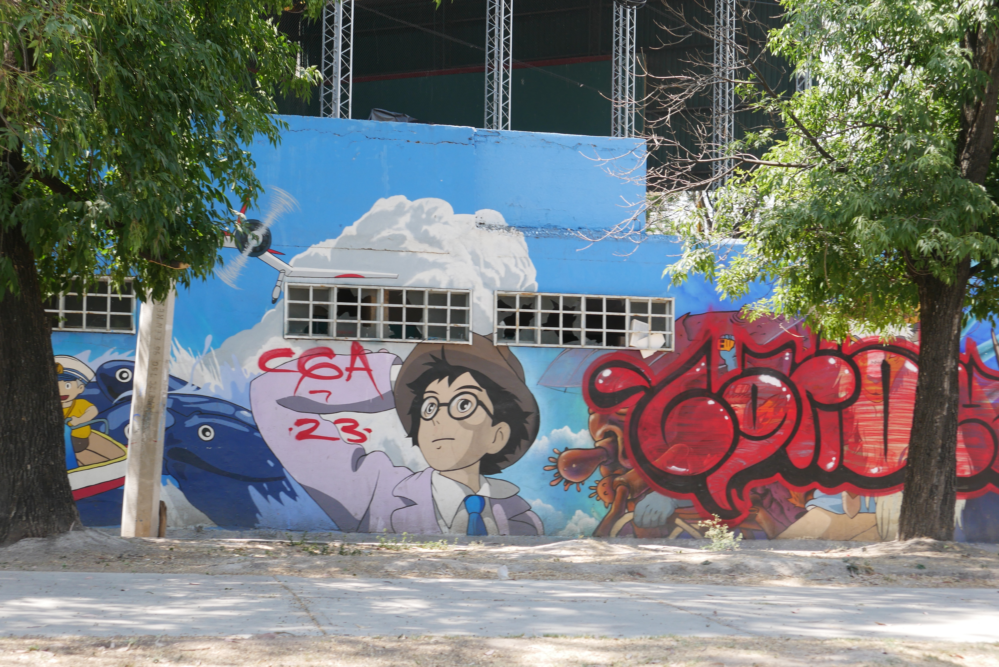

In [34]:
display.display(display.Image(filename=kiki))
display.display(display.HTML('<a "href=https://commons.wikimedia.org/wiki/File:Mural_Studio_Ghibli_en_Aguascalientes_con_grafiti_encima_02.jpg"></a>'))

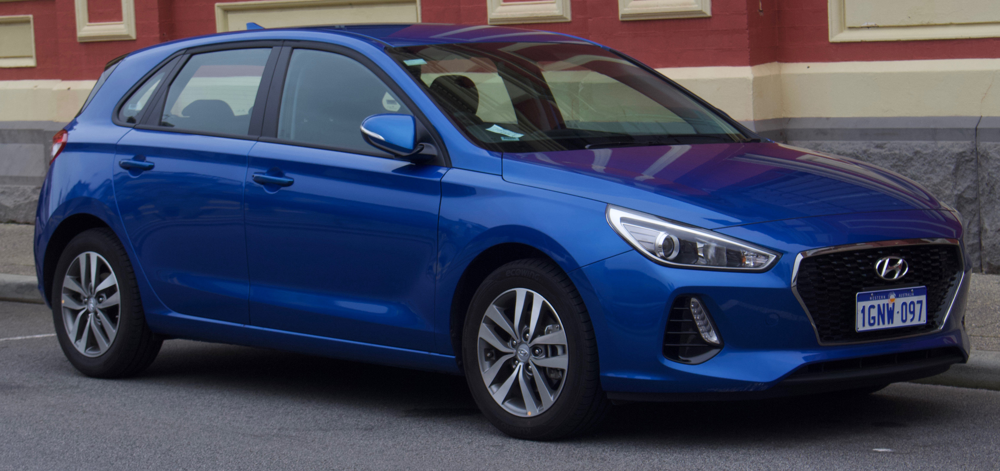

In [40]:
display.display(display.Image(filename=hyundai))
display.display(display.HTML('<a "href=https://commons.wikimedia.org/wiki/File:2018_Hyundai_i30_(PD_MY18)_Active_5-door_hatchback_(2018-08-06)_01.jpg"></a>'))

In [41]:
image_labels={
    kiki:0,
    hyundai:1
}

In [64]:
image_string=open(kiki, 'rb').read() #byte type, TensorShape([3064, 4592, 3])
label=image_labels[kiki]

# decode_jpeg
# Decode a JPEG-encoded image to a uint8 tensor.
def image_example(image_string, label):
  image_shape=tf.io.decode_jpeg(image_string).shape

  feature={
      'height':_int64_feature(image_shape[0]),
      'width':_int64_feature(image_shape[1]),
      'depth':_int64_feature(image_shape[2]),
      'label':_int64_feature(label),
      'image_raw':_bytes_feature(image_string)
  }
#all of the features are now stored in the tf.train.Example message
  return tf.train.Example(features=tf.train.Features(feature=feature))

for line in str(image_example(image_string, label)).split('\n')[:15]:
  print(line)
print('...')

features {
  feature {
    key: "depth"
    value {
      int64_list {
        value: 3
      }
    }
  }
  feature {
    key: "height"
    value {
      int64_list {
        value: 3064
      }
...


In [65]:
#You now have the file—images.tfrecords

record_file='images.tfrecords'

with tf.io.TFRecordWriter(record_file) as writer:
  for filename, label in image_labels.items():
    image_string=open(filename, 'rb').read()
    tf_example=image_example(image_string, label)
    writer.write(tf_example.SerializeToString())

In [67]:
#can now iterate over the records in it to read back

#TFRecordDataset
#This dataset loads TFRecords from the files as bytes, exactly as they were written.
raw_image_dataset=tf.data.TFRecordDataset('images.tfrecords')

image_feature_description={
    'height':tf.io.FixedLenFeature([], tf.int64),
    'width':tf.io.FixedLenFeature([], tf.int64),
    'depth':tf.io.FixedLenFeature([], tf.int64),
    'label':tf.io.FixedLenFeature([], tf.int64),
    'image_raw':tf.io.FixedLenFeature([], tf.string)
}

def _parse_image_function(example_proto):
  #parse the input tf.train.Example proto using the dictionary above.
  return tf.io.parse_single_example(example_proto, image_feature_description)

#map
#This transformation applies map_func to each element of this dataset, and returns a new dataset containing the transformed elements, in the same order as they appeared in the input.
parsed_image_dataset=raw_image_dataset.map(_parse_image_function)

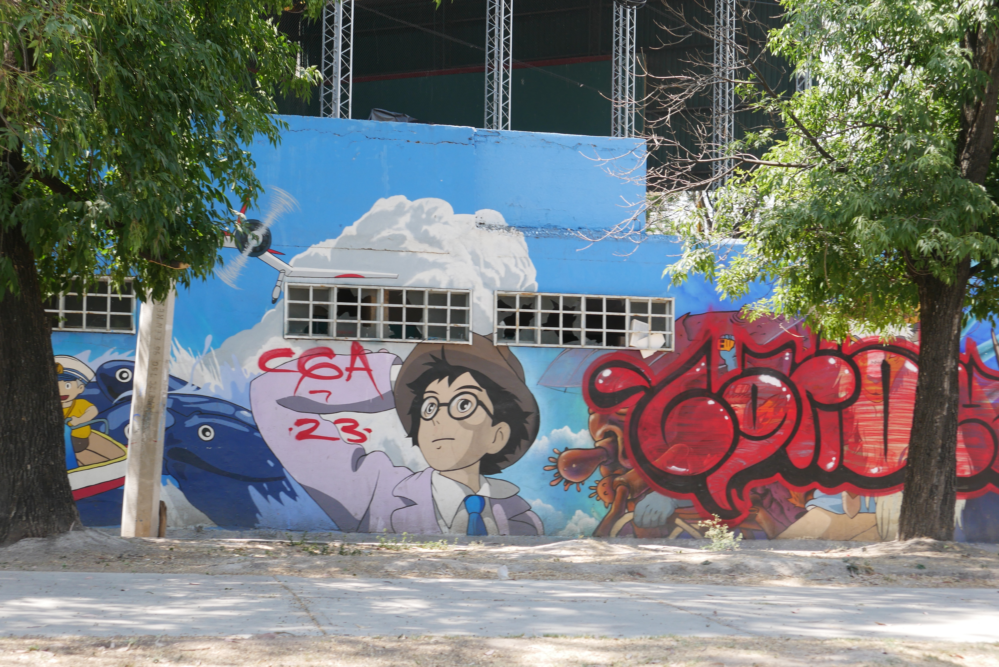

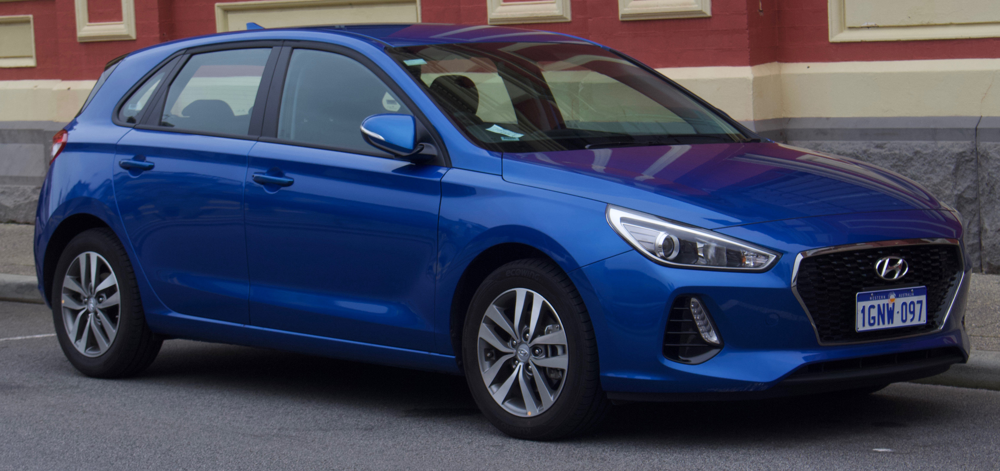

In [69]:
#recover the images from the TFRecord file
for image_features in parsed_image_dataset:
  image_raw=image_features['image_raw'].numpy()
  display.display(display.Image(data=image_raw))